In [26]:
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import leafmap

In [2]:
df = pd.read_csv("E:/TECH AI TASKS/Meteorite Landing - Meteorite-Landings.csv")

In [3]:
df.head()

,Name,ID,NameType,Classification,Mass,Fall,Year,Coordinates
0,Aachen,1,Valid,L5,"Quantity[21, ""Grams""]",Fell,"DateObject[{1880}, ""Year"", ""Gregorian"", -5.]","GeoPosition[{50.775, 6.08333}]"
1,Aarhus,2,Valid,H6,"Quantity[720, ""Grams""]",Fell,"DateObject[{1951}, ""Year"", ""Gregorian"", -5.]","GeoPosition[{56.18333, 10.23333}]"
2,Abee,6,Valid,EH4,"Quantity[107000, ""Grams""]",Fell,"DateObject[{1952}, ""Year"", ""Gregorian"", -5.]","GeoPosition[{54.21667, -113.}]"
3,Acapulco,10,Valid,Acapulcoite,"Quantity[1914, ""Grams""]",Fell,"DateObject[{1976}, ""Year"", ""Gregorian"", -5.]","GeoPosition[{16.88333, -99.9}]"
4,Achiras,370,Valid,L6,"Quantity[780, ""Grams""]",Fell,"DateObject[{1902}, ""Year"", ""Gregorian"", -5.]","GeoPosition[{-33.16667, -64.95}]"


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45716 entries, 0 to 45715
Data columns (total 8 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Name            45716 non-null  object
 1   ID              45716 non-null  int64 
 2   NameType        45716 non-null  object
 3   Classification  45716 non-null  object
 4   Mass            45716 non-null  object
 5   Fall            45716 non-null  object
 6   Year            45716 non-null  object
 7   Coordinates     45716 non-null  object
dtypes: int64(1), object(7)
memory usage: 2.8+ MB


In [5]:
df.describe(include='object')

,Name,NameType,Classification,Mass,Fall,Year,Coordinates
count,45716,45716,45716,45716,45716,45716,45716
unique,45716,2,466,12577,2,265,17100
top,Aachen,Valid,L6,"Quantity[1.3, ""Grams""]",Found,"DateObject[{2003}, ""Year"", ""Gregorian"", -5.]","Missing[""NotAvailable""]"
freq,1,45641,8285,171,44609,3323,13529


In [6]:
#Converting Mass into numeric value mass_kg (Created a new column)
df['mass_kg'] = df['Mass'].str.extract(r'Quantity\[\s*([+-]?\d+(?:\.\d+)?)\s*,', expand=False)
df['mass_kg'] = pd.to_numeric(df['mass_kg'], errors='coerce').round(0).astype('Float64')
df["mass_kg"] = (df["mass_kg"] / 1000).astype("Float64")

In [7]:
#Converting Year into numeric value year (Created a new column)
res = df['Year'].str.extract(r'(?:DateObject\[\{\s*([0-9]{4})\s*\}|([0-9]{4}))', expand=True)
df['year'] = res[0].fillna(res[1]).astype('Int64')

In [8]:
#Converting Coordinates into - Latitude and Longitude (Created 2 new columns)
coords = (df["Coordinates"].astype(str)
    .str.replace(r"GeoPosition\[\{|\}\]", "", regex=True).str.split(",", n=1, expand=True).rename(columns={0: "lat_str", 1: "lon_str"}))

df[["latitude", "longitude"]] = coords.assign(
    latitude=pd.to_numeric(coords["lat_str"].str.strip(), errors="coerce"),
    longitude=pd.to_numeric(coords["lon_str"].str.strip(), errors="coerce")
)[["latitude", "longitude"]]

In [9]:
df.describe()

,ID,mass_kg,year,latitude,longitude
count,45716.000000,45585.0,45422.0,32187.000000,32187.000000
mean,26889.735104,13.278077,1991.874928,-46.675559,72.854090
std,16860.683030,574.988876,23.956664,47.049897,83.055587
min,1.000000,0.0,1399.0,-87.366670,-165.433330
25%,12688.750000,0.007,1987.0,-79.683330,26.000000
50%,24261.500000,0.033,1998.0,-72.000000,56.646250
75%,40656.750000,0.203,2003.0,18.536165,159.386110
max,57458.000000,60000.0,2013.0,81.166670,178.200000


In [10]:
#Now we can delete initial columns mass and year as we have shifted the numeric values into new columns
df.drop(columns=["Mass", "Year"], inplace=True)

In [11]:
#There are lots of rows where mass given is 0, which affect calculations (Filtering out erroneous data)
df["mass_kg"] = df["mass_kg"].replace(0, pd.NA).astype("Float64") 

In [12]:
#Finding the top 10 heaviest meteorites
heaviest_meteorites = df.nlargest(10, "mass_kg").reset_index(drop=True)
print(heaviest_meteorites[["Name","mass_kg","Classification","year"]])

                    Name  mass_kg   Classification  year
0                   Hope  60000.0        Iron, IVB  1920
1           Catalina 011  58200.0      Iron, IIIAB  1818
2           Catalina 003  50000.0     Iron, IAB-MG  1575
3           Catalina 008  30000.0     Iron, IAB-MG  1891
4             Asuka 8602  28000.0       Iron, IIIE  1898
5      Glorieta Mountain  26000.0        Iron, IVA  1836
6       Colorado Springs  24300.0      Iron, IIIAB  1852
7        Mundrabilla 005  24000.0    Iron, IAB-ung  1911
8                  Sinai  23000.0       Iron, IIAB  1947
9  Bates Nunataks A78005  22000.0  Iron, ungrouped  1863


In [13]:
# Count of Fell vs. Found meteorites
fell_vs_found = df['Fall'].value_counts(dropna=False)
print(fell_vs_found)
pct = df["Fall"].value_counts(normalize=True) * 100
print(pct.round(2))

Fall
Found    44609
Fell      1107
Name: count, dtype: int64
Fall
Found    97.58
Fell      2.42
Name: proportion, dtype: float64


In [14]:
# Average mass for the most common classifications
top_classification = df["Classification"].value_counts().head(10).index.tolist()
agg = (df[df["Classification"].isin(top_classification)].groupby(df["Classification"])
    .agg(count=("mass_kg", "count"),mean_mass=("mass_kg", "mean"),median_mass=("mass_kg", "median")).reindex(top_classification))
agg["mean_mass"] = agg["mean_mass"].round(2)
agg["median_mass"] = agg["median_mass"].round(2)
print(agg)

                count  mean_mass  median_mass
Classification                               
L6               8166       1.47         0.04
H5               7019        2.2         0.03
L5               4660       1.85         0.04
H6               4446       0.88         0.02
H4               4162       1.01         0.02
LL5              2713       0.47         0.02
LL6              2028        0.7         0.03
L4               1243       1.65         0.07
H4/5              426       1.61         0.01
CM2               407       0.37         0.01


In [15]:
# Grouping data by decades
df_year = df.dropna(subset=["year"]).copy()
df_year["decade"] = (df_year["year"] // 10 * 10).astype("Int64")
decade_counts = (df_year.groupby("decade").size().rename("count").reset_index().sort_values("decade"))
decade_counts.sort_values("decade", ascending=False, inplace=True)
print(decade_counts.head(10))

    decade  count
43    2010   1963
42    2000  17757
41    1990  11619
40    1980   6822
39    1970   4969
38    1960    397
37    1950    212
36    1940    196
35    1930    309
34    1920    159


In [16]:
# Calculating the mean,median,standard deviation, sum and max values of mass_kg column.
mass_arr = df["mass_kg"].dropna().to_numpy(dtype=float)
mean = np.mean(mass_arr)
median = np.median(mass_arr)
std = np.std(mass_arr)     
sum = np.sum(mass_arr)
max = np.max(mass_arr)

print("count:", mass_arr.size)
print("mean:", mean)
print("median:", median)
print("std:", std)
print("sum:", sum)
print("max:", max)

count: 44860
mean: 13.492668880962995
median: 0.034
std: 579.6077086448424
sum: 605281.1259999999
max: 60000.0


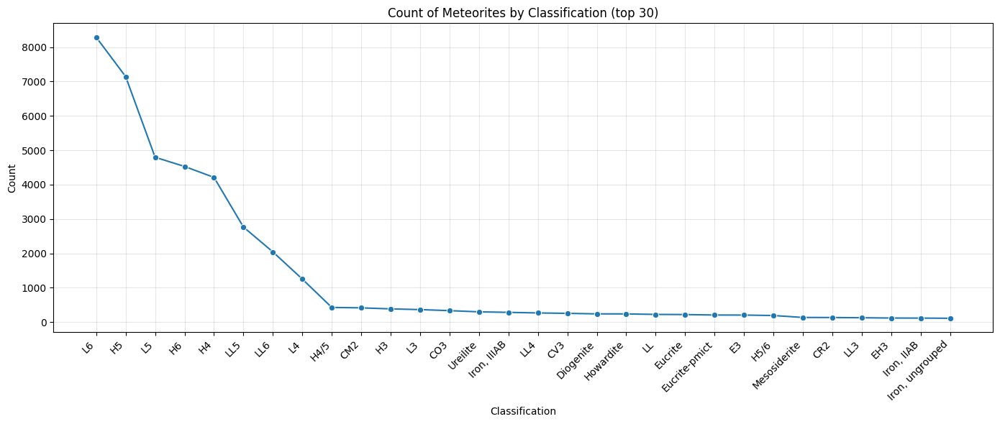

In [17]:
# Bar chat plot of Classification of Meteorites vs Count
classification_counts = (df["Classification"].dropna().value_counts())
top_n = 30
counts_plot = classification_counts.nlargest(top_n).sort_values(ascending=False)
plt.figure(figsize=(14,6))
sns.lineplot(x=counts_plot.index, y=counts_plot.values, marker="o")
plt.xticks(rotation=45, ha="right")
plt.xlabel("Classification")
plt.ylabel("Count")
plt.title(f"Count of Meteorites by Classification (top {top_n})")
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

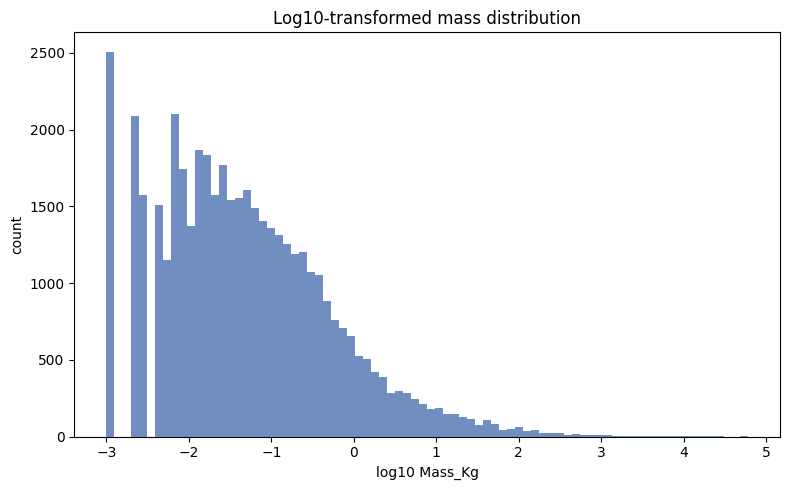

In [18]:
#Converting mass to log because data is skewed, high frequency of low values and low frquency of high values.
mass = df["mass_kg"].dropna().astype(float)
plt.figure(figsize=(8,5))
plt.hist(np.log10(mass + 1e-9), bins=80, color="#4c72b0", alpha=0.8)
plt.xlabel("log10 Mass_Kg")
plt.ylabel("count")
plt.title("Log10-transformed mass distribution")
plt.tight_layout()
plt.show()

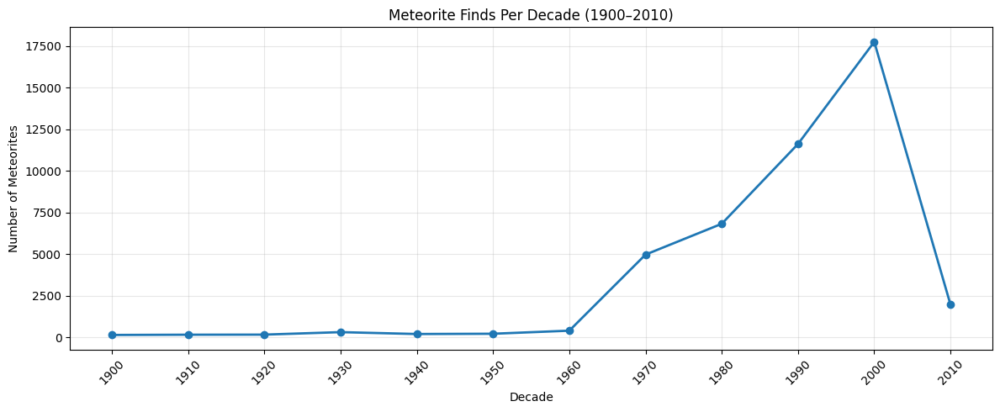

In [19]:
# Meteorites found per decade from 1900-2010
decade_counts = decade_counts[(decade_counts["decade"] >= 1900) & (decade_counts["decade"] <= 2010)]
plt.figure(figsize=(12,5))
plt.plot(decade_counts["decade"], decade_counts["count"], marker="o", linewidth=2)
plt.xticks(decade_counts["decade"], rotation=45)
plt.xlabel("Decade")
plt.ylabel("Number of Meteorites")
plt.title("Meteorite Finds Per Decade (1900–2010)")
plt.grid(alpha=0.3)
plt.tight_layout()

C:\Users\Rayansh\AppData\Local\Temp\ipykernel_28216\2337999090.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x="Classification", y="log_mass", data=sub, inner="quartile", scale="width", palette="Set2")
C:\Users\Rayansh\AppData\Local\Temp\ipykernel_28216\2337999090.py:6: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(x="Classification", y="log_mass", data=sub, inner="quartile", scale="width", palette="Set2")


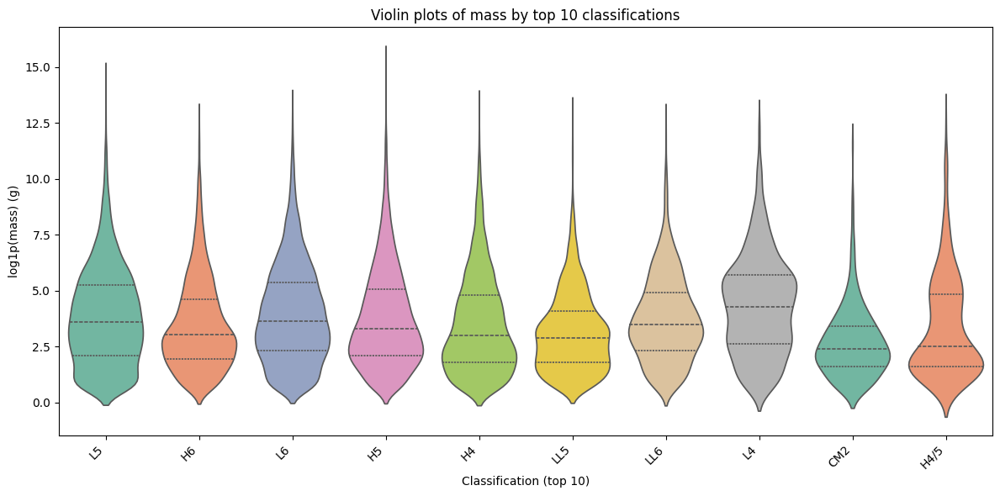

In [20]:
# Bassed on classification, we can calculate Median, 25th and 75th percentile using Violin chart.
sub = df[df["Classification"].isin(top_classification)].dropna(subset=["mass_kg", "Classification"]).copy()
sub["mass_g"] = (sub["mass_kg"].astype(float) * 1000).astype("Float64")
sub["log_mass"] = np.log1p(sub["mass_g"])
plt.figure(figsize=(12,6))
sns.violinplot(x="Classification", y="log_mass", data=sub, inner="quartile", scale="width", palette="Set2")
plt.xticks(rotation=45, ha="right")
plt.xlabel("Classification (top 10)")
plt.ylabel("log1p(mass) (g)")
plt.title("Violin plots of mass by top 10 classifications")
plt.tight_layout()
plt.show()

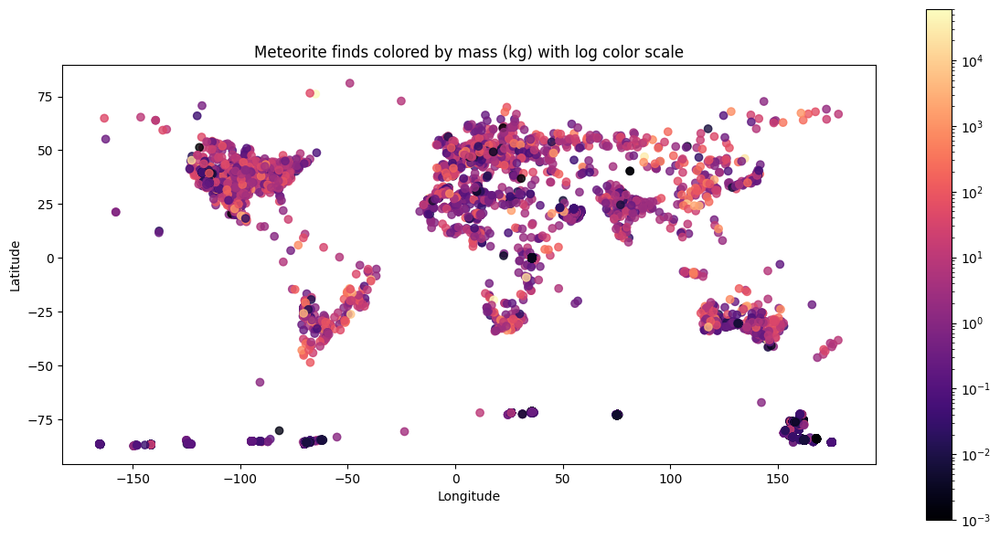

In [28]:
from matplotlib.colors import LogNorm
gdf_plot = gdf.copy()
gdf_plot["mass_kg"] = pd.to_numeric(gdf_plot["mass_kg"], errors="coerce")
gdf_plot = gdf_plot[gdf_plot["mass_kg"].notna() & (gdf_plot["mass_kg"] > 0)].copy()

fig, ax = plt.subplots(figsize=(12,6))
gdf_plot.plot(
    ax=ax,
    column="mass_kg",
    cmap="magma",
    legend=True,
    norm=LogNorm(vmin=gdf_plot["mass_kg"].min(), vmax=gdf_plot["mass_kg"].max()),
    alpha=0.8
)
ax.set_title("Meteorite finds colored by mass (kg) with log color scale")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.tight_layout()
plt.show()

In [21]:
from shapely.geometry import Point
loc = df.dropna(subset=["latitude", "longitude"]).copy()
loc["latitude"] = pd.to_numeric(loc["latitude"], errors="coerce")
loc["longitude"] = pd.to_numeric(loc["longitude"], errors="coerce")
loc = loc.dropna(subset=["latitude", "longitude"])
loc["geometry"] = [Point(xy) for xy in zip(loc["longitude"], loc["latitude"])]
gdf = gpd.GeoDataFrame(loc, geometry="geometry", crs="EPSG:4326")

In [24]:
gdf.explore()